In [2]:
import numpy as np
import sys
import os
import pandas as pd
sys.path.append(os.path.join(os.getcwd(), "src"))
from sklearn.datasets import fetch_openml
from sklearn.model_selection import train_test_split
from sklearn.utils import check_random_state
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from ffnn import FFNN

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import f1_score, confusion_matrix, classification_report, log_loss, roc_auc_score, cohen_kappa_score, precision_recall_fscore_support

# Load Data

In [3]:
# Load data from https://www.openml.org/d/554
X, y = fetch_openml("mnist_784", version=1, return_X_y=True, as_frame=False)

In [4]:
print(X.shape)
print(y.shape) 

(70000, 784)
(70000,)


In [5]:
random_state = check_random_state(0)
permutation = random_state.permutation(X.shape[0])
X = X[permutation]
y = y[permutation]
X = X.reshape((X.shape[0], -1))

# one-hot encode labels
encoder = OneHotEncoder(sparse=False, categories='auto')
y_encoded = encoder.fit_transform(y.reshape(-1, 1))

# train-test split
X_train, X_val, y_train, y_val = train_test_split(X, y_encoded, test_size=0.2, random_state=42)


# Function

In [6]:
def validate_model(model, y_val_encoded, y_val_pred, y_val_pred_proba, label_encoder):
  # Precision, Recall, F1-Score (Weighted and Macro)
  precision, recall, f1, _ = precision_recall_fscore_support(
      y_val_encoded, y_val_pred, average='weighted')
  macro_f1 = f1_score(y_val_encoded, y_val_pred, average='macro')
  print(f"Weighted F1-Score: {f1:.4f}")
  print(f"Macro F1-Score: {macro_f1:.4f}")

  # Cohen's Kappa
  kappa = cohen_kappa_score(y_val_encoded, y_val_pred)
  print(f"Cohen's Kappa: {kappa:.4f}")

  # ROC-AUC (One-vs-Rest for Multi-Class)
  try:
      roc_auc = roc_auc_score(y_val_encoded, y_val_pred_proba, multi_class='ovr', average='weighted')
      print(f"ROC-AUC (Weighted): {roc_auc:.4f}")
  except ValueError:
      print("ROC-AUC could not be computed for this dataset.")

  # Log Loss
  logloss = log_loss(y_val_encoded, y_val_pred_proba)
  print(f"\nValidation Log Loss: {logloss:.4f}")


  # Classfication Report
  print("\nClassification Report:")
  print(classification_report(label_encoder.inverse_transform(y_val_encoded),
                              label_encoder.inverse_transform(y_val_pred),
                              target_names=[str(cls) for cls in label_encoder.classes_] ))

  # Confusion Matrix
  print()
  conf_matrix_id3 = confusion_matrix(label_encoder.inverse_transform(y_val_encoded),
                                    label_encoder.inverse_transform(y_val_pred),
                                    labels=label_encoder.classes_)

  plt.figure(figsize=(8, 6))
  sns.heatmap(conf_matrix_id3, annot=True, fmt='d', cmap='Blues',
              xticklabels=[str(cls) for cls in label_encoder.classes_], 
              yticklabels=[str(cls) for cls in label_encoder.classes_])
  plt.xlabel('Predicted Labels')
  plt.ylabel('True Labels')
  plt.title('Confusion Matrix')
  plt.show()



# Testing

## Pengaruh Learning Rate

In [7]:
print("\n==== Testing Different Activation Functions ====")

histories = {
        'history': [],
        'accuracy': [],
        'model' : []
    }
layer_sizes = [784, 150, 75, 10] 
learning_rate = [0.1, 0.05, 0.01, 0.005, 0.001, 0.0005, 0.0001]
for l in learning_rate:
    print(f"\nTraining with learning rate: {l}")
    
    # For all tests, use sigmoid in the output layer with MSE loss
    activation_funcs = ["relu", "relu", "softmax"]
    
    # Initialize model
    model = FFNN(
        layer_sizes=layer_sizes,
        activation_funcs=activation_funcs,
        weight_init="he",
        loss_function="cce",
        seed=42
    )
    
    # Train model and time it
    history = model.train(
        X_train, y_train,
        X_val=X_val, y_val=y_val,
        batch_size=64,
        learning_rate=l,
        epochs=20,
        verbose=0
    )
    
    # Get predictions on test set
    y_pred = model.predict(X_val)
    
    # Calculate accuracy - get argmax for one-hot encoded outputs
    y_val_labels = np.argmax(y_val, axis=1)
    y_pred_labels = np.argmax(y_pred, axis=1)
    accuracy = np.mean(y_val_labels == y_pred_labels)
    
    print(f"Test accuracy: {accuracy:.4f}") 
    print(f"Train loss: {history['train_loss'][19]:.4f}")
    print(f"Val loss: {history['val_loss'][19]:.4f}")
    
    # Store history and model
    histories[l] = {
        'history': history,
        'accuracy': accuracy,
        'model': model
    }


==== Testing Different Activation Functions ====

Training with learning rate: 0.1
Test accuracy: 0.1111
Train loss: 2.3014
Val loss: 2.3067

Training with learning rate: 0.05
Test accuracy: 0.1111
Train loss: 2.3012
Val loss: 2.3042

Training with learning rate: 0.01
Test accuracy: 0.1111
Train loss: 2.3011
Val loss: 2.3017

Training with learning rate: 0.005
Test accuracy: 0.1111
Train loss: 2.3011
Val loss: 2.3053

Training with learning rate: 0.001
Test accuracy: 0.9434
Train loss: 0.1079
Val loss: 0.2458

Training with learning rate: 0.0005
Test accuracy: 0.9336
Train loss: 0.1225
Val loss: 0.2979

Training with learning rate: 0.0001
Test accuracy: 0.9094
Train loss: 0.3160
Val loss: 0.7316


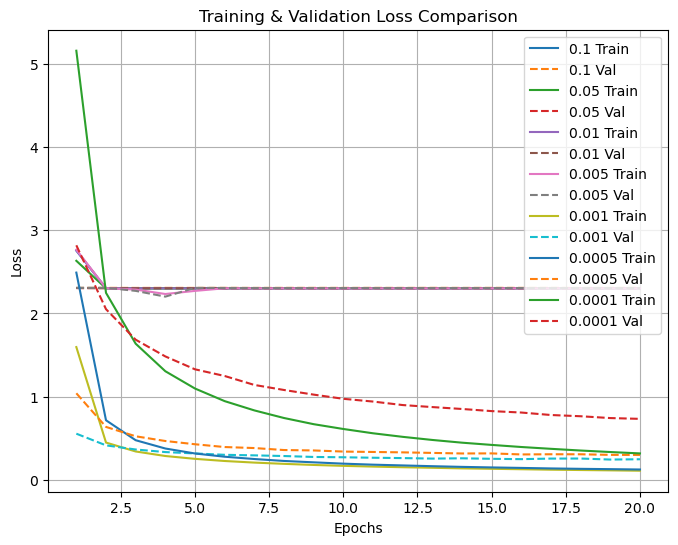

Visualisasi learning rate 0.1


c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero

Weighted F1-Score: 0.0222
Macro F1-Score: 0.0200
Cohen's Kappa: 0.0000
ROC-AUC (Weighted): 0.5000

Validation Log Loss: 2.3067

Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1402
           1       0.11      1.00      0.20      1556
           2       0.00      0.00      0.00      1368
           3       0.00      0.00      0.00      1339
           4       0.00      0.00      0.00      1395
           5       0.00      0.00      0.00      1261
           6       0.00      0.00      0.00      1418
           7       0.00      0.00      0.00      1463
           8       0.00      0.00      0.00      1362
           9       0.00      0.00      0.00      1436

    accuracy                           0.11     14000
   macro avg       0.01      0.10      0.02     14000
weighted avg       0.01      0.11      0.02     14000




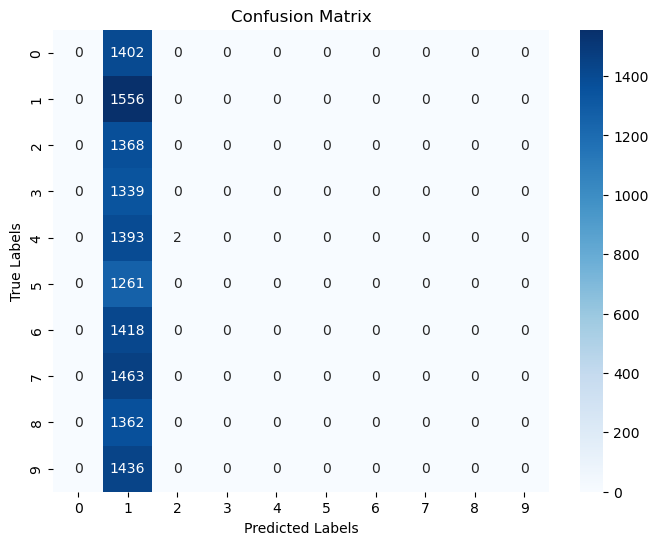

Visualisasi learning rate 0.05


c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero

Weighted F1-Score: 0.0222
Macro F1-Score: 0.0200
Cohen's Kappa: 0.0000
ROC-AUC (Weighted): 0.5000

Validation Log Loss: 2.3042

Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1402
           1       0.11      1.00      0.20      1556
           2       0.00      0.00      0.00      1368
           3       0.00      0.00      0.00      1339
           4       0.00      0.00      0.00      1395
           5       0.00      0.00      0.00      1261
           6       0.00      0.00      0.00      1418
           7       0.00      0.00      0.00      1463
           8       0.00      0.00      0.00      1362
           9       0.00      0.00      0.00      1436

    accuracy                           0.11     14000
   macro avg       0.01      0.10      0.02     14000
weighted avg       0.01      0.11      0.02     14000




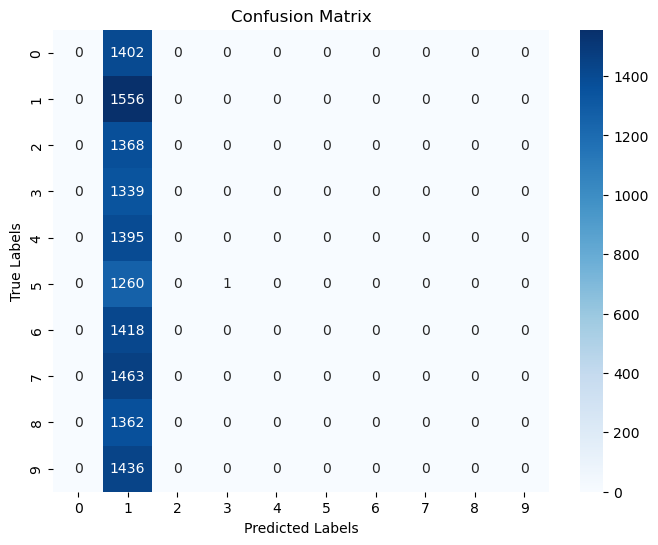

Visualisasi learning rate 0.01


c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero

Weighted F1-Score: 0.0222
Macro F1-Score: 0.0200
Cohen's Kappa: 0.0000
ROC-AUC (Weighted): 0.5000

Validation Log Loss: 2.3017

Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1402
           1       0.11      1.00      0.20      1556
           2       0.00      0.00      0.00      1368
           3       0.00      0.00      0.00      1339
           4       0.00      0.00      0.00      1395
           5       0.00      0.00      0.00      1261
           6       0.00      0.00      0.00      1418
           7       0.00      0.00      0.00      1463
           8       0.00      0.00      0.00      1362
           9       0.00      0.00      0.00      1436

    accuracy                           0.11     14000
   macro avg       0.01      0.10      0.02     14000
weighted avg       0.01      0.11      0.02     14000




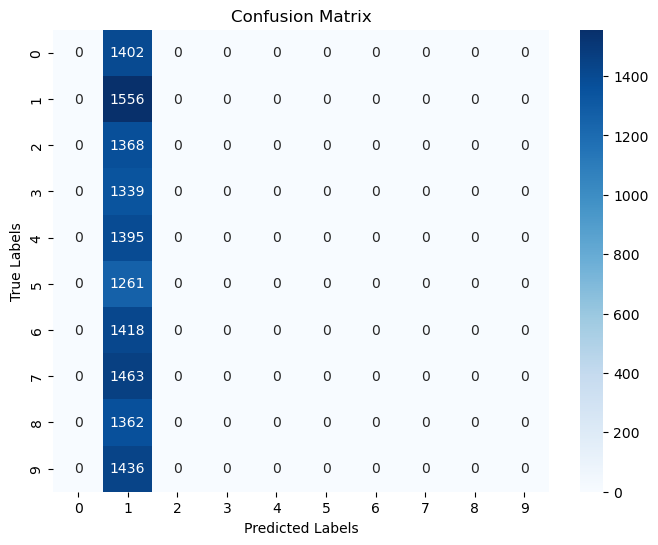

Visualisasi learning rate 0.005


c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Keanu\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero

Weighted F1-Score: 0.0224
Macro F1-Score: 0.0201
Cohen's Kappa: -0.0001
ROC-AUC (Weighted): 0.5000

Validation Log Loss: 2.3053

Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1402
           1       0.11      1.00      0.20      1556
           2       0.00      0.00      0.00      1368
           3       0.00      0.00      0.00      1339
           4       0.50      0.00      0.00      1395
           5       0.00      0.00      0.00      1261
           6       0.00      0.00      0.00      1418
           7       0.00      0.00      0.00      1463
           8       0.00      0.00      0.00      1362
           9       0.00      0.00      0.00      1436

    accuracy                           0.11     14000
   macro avg       0.06      0.10      0.02     14000
weighted avg       0.06      0.11      0.02     14000




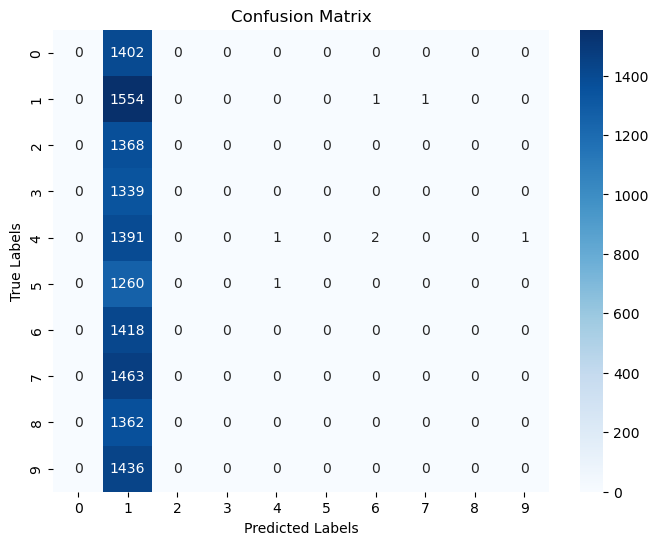

Visualisasi learning rate 0.001


Weighted F1-Score: 0.9433
Macro F1-Score: 0.9428
Cohen's Kappa: 0.9370
ROC-AUC (Weighted): 0.9961

Validation Log Loss: 0.2458

Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.96      0.96      1402
           1       0.97      0.99      0.98      1556
           2       0.94      0.94      0.94      1368
           3       0.93      0.91      0.92      1339
           4       0.94      0.93      0.94      1395
           5       0.92      0.95      0.94      1261
           6       0.97      0.95      0.96      1418
           7       0.95      0.94      0.94      1463
           8       0.93      0.95      0.94      1362
           9       0.92      0.91      0.92      1436

    accuracy                           0.94     14000
   macro avg       0.94      0.94      0.94     14000
weighted avg       0.94      0.94      0.94     14000




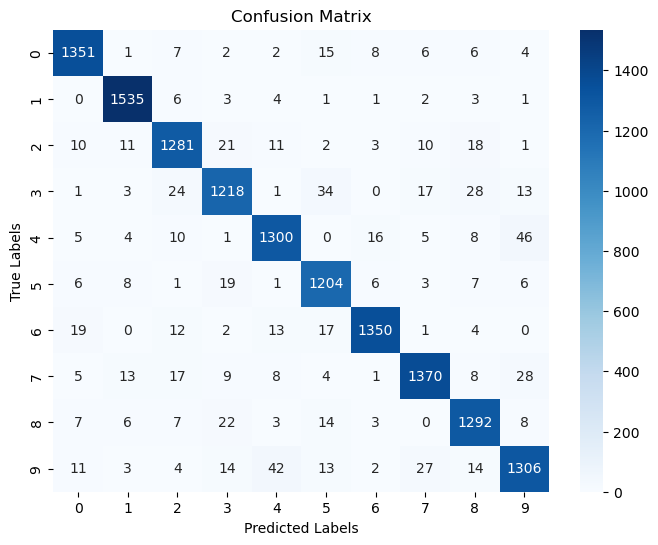

Visualisasi learning rate 0.0005


Weighted F1-Score: 0.9336
Macro F1-Score: 0.9328
Cohen's Kappa: 0.9262
ROC-AUC (Weighted): 0.9952

Validation Log Loss: 0.2979

Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.97      0.96      1402
           1       0.97      0.98      0.98      1556
           2       0.92      0.94      0.93      1368
           3       0.92      0.92      0.92      1339
           4       0.94      0.93      0.93      1395
           5       0.91      0.91      0.91      1261
           6       0.96      0.94      0.95      1418
           7       0.94      0.93      0.94      1463
           8       0.90      0.92      0.91      1362
           9       0.92      0.90      0.91      1436

    accuracy                           0.93     14000
   macro avg       0.93      0.93      0.93     14000
weighted avg       0.93      0.93      0.93     14000




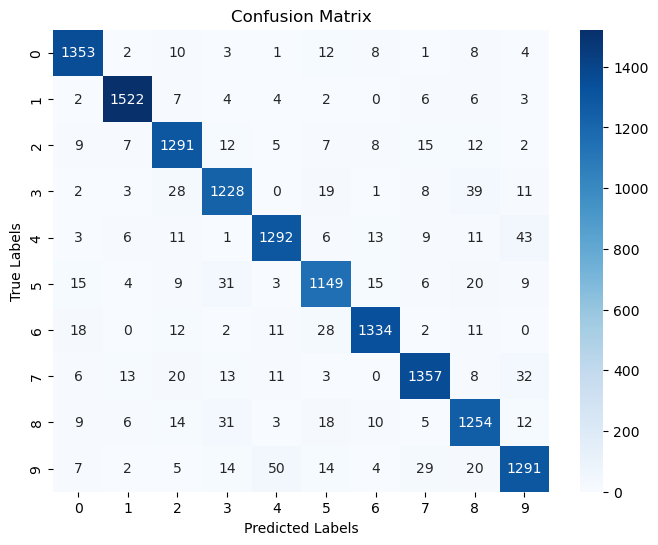

Visualisasi learning rate 0.0001


Weighted F1-Score: 0.9094
Macro F1-Score: 0.9082
Cohen's Kappa: 0.8993
ROC-AUC (Weighted): 0.9930

Validation Log Loss: 0.7316

Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.95      0.95      1402
           1       0.97      0.98      0.97      1556
           2       0.91      0.92      0.91      1368
           3       0.87      0.88      0.87      1339
           4       0.91      0.90      0.90      1395
           5       0.90      0.87      0.88      1261
           6       0.95      0.93      0.94      1418
           7       0.91      0.91      0.91      1463
           8       0.86      0.88      0.87      1362
           9       0.87      0.87      0.87      1436

    accuracy                           0.91     14000
   macro avg       0.91      0.91      0.91     14000
weighted avg       0.91      0.91      0.91     14000




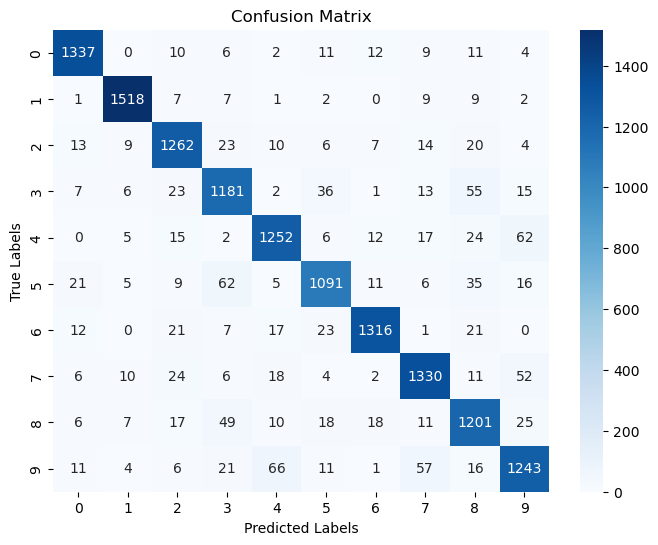

In [8]:
# Plot 1: Training and Validation Loss comparison
plt.figure(figsize=(8, 6))
for l in learning_rate:
    plt.plot(range(1, 21), histories[l]['history']['train_loss'], label=f"{l} Train")
    plt.plot(range(1, 21), histories[l]['history']['val_loss'], linestyle="dashed", label=f"{l} Val")

plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Training & Validation Loss Comparison")
plt.legend()
plt.grid(True)
plt.show()

for l in learning_rate:
    if l != "linear":
        print(f"Visualisasi learning rate {l}")
        model = histories[l]["model"]
        model.visualize_weight_distribution()
        model.visualize_gradient_weight_distribution()

        predictions = model.predict(X_val)

        label_encoder = LabelEncoder()
        label_encoder.fit(np.arange(10))

        y_val_encoded = np.argmax(y_val, axis=1)
        y_val_pred = np.argmax(predictions, axis=1) 
        y_val_pred_proba = predictions
        validate_model(model, y_val_encoded, y_val_pred, y_val_pred_proba, label_encoder)

        